#### Use k-means clustering with k set to 16 and cluster the image, which means that you want to keep just 16 colors in our compressed image.

Open and display the image “tiger.png”. Convert the image into numpy array, so that it can be used in further processing. Find out the dimensions of the image and convert it into a two-dimensional array (Use k-means clustering for image segmentation, reducing the image into 16 colors)

##### Step1: Import Libraries

In [1]:
from sklearn.cluster import KMeans
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
%matplotlib inline

#### Step2: Get the Image and its corresponding RGB Values

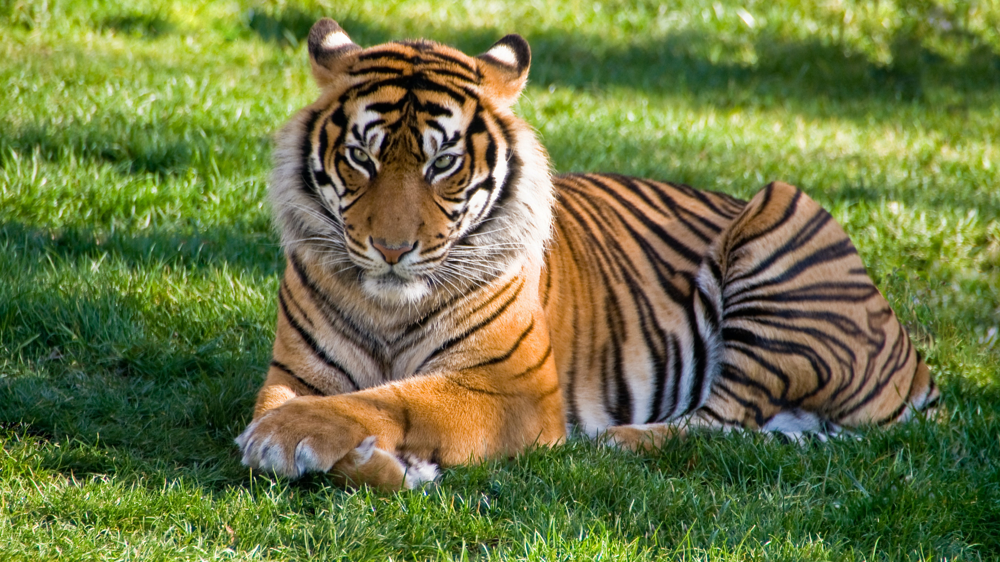

In [2]:
img = Image.open('tiger.png')
img

In [3]:
img_np = np.asarray(img)
img_np

array([[[ 96, 131,   3],
        [ 98, 133,   3],
        [ 99, 138,  13],
        ...,
        [179, 188,  79],
        [176, 184,  75],
        [172, 182,  70]],

       [[ 95, 131,   5],
        [ 99, 134,   8],
        [ 99, 137,  15],
        ...,
        [178, 187,  78],
        [175, 183,  74],
        [172, 182,  70]],

       [[ 95, 134,   9],
        [ 98, 137,  10],
        [100, 140,  18],
        ...,
        [174, 186,  76],
        [173, 182,  73],
        [172, 182,  70]],

       ...,

       [[ 99, 120,  19],
        [ 81, 101,   2],
        [ 80, 100,   1],
        ...,
        [  7,  46,   1],
        [  7,  53,   4],
        [  9,  55,   6]],

       [[ 98, 118,  23],
        [ 83, 103,   6],
        [ 85, 105,   6],
        ...,
        [  7,  49,   3],
        [ 10,  56,   9],
        [ 12,  58,  11]],

       [[100, 120,  33],
        [ 87, 106,  17],
        [ 83, 104,   9],
        ...,
        [  8,  50,   4],
        [  9,  57,   9],
        [ 11,  57,  10]]

In [4]:
img_np[0:2]

array([[[ 96, 131,   3],
        [ 98, 133,   3],
        [ 99, 138,  13],
        ...,
        [179, 188,  79],
        [176, 184,  75],
        [172, 182,  70]],

       [[ 95, 131,   5],
        [ 99, 134,   8],
        [ 99, 137,  15],
        ...,
        [178, 187,  78],
        [175, 183,  74],
        [172, 182,  70]]], dtype=uint8)

#### Step3: Get the Image Dimensions

In [5]:
img_np.shape

(2160, 3840, 3)

For feeding this data into the algorithm, you must change the shape of this data into a dataset with 2160*3840 = 8294400 rows and 3 columns

#### Step4: Reshape the Data

In [6]:
pixels = img_np.reshape(img_np.shape[0]*img_np.shape[1], img_np.shape[2])
pixels.shape

(8294400, 3)

#### Step5: Define the k-means Model

In [7]:
model = KMeans(n_clusters=16)
model.fit(pixels)

C:\Users\srika\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1412: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


KMeans(n_clusters=16)

After the model is trained, model.labels_ is used to obtain the number of cluster that is assigned to 
each data point or each pixel. 
model.cluster_centers_ gives us the coordinates or the RGB values of the 16 cluster center

#### Step6: Define the Cluster Centers

In [8]:
pixels_centroids = model.labels_
pixels_centroids

array([14, 14, 14, ...,  8,  8,  8])

In [9]:
pixels_centroids.shape[0]

8294400

In [10]:
cluster_centers = model.cluster_centers_
cluster_centers

array([[ 33.47756511,  69.91797312,  25.40494773],
       [178.53623651, 198.29424352, 104.55717287],
       [113.31738273,  85.27609687,  58.3847533 ],
       [163.03632812, 150.30530259, 137.00129881],
       [ 97.43929881, 128.46999091,  62.57700445],
       [206.09260002, 204.41432625, 159.92849451],
       [ 58.50107433,  91.86156219,  52.99348965],
       [147.54402516, 173.21953992,  73.60317793],
       [ 14.79286091,  30.93812111,  12.37620586],
       [168.47942906, 115.86789626,  60.61521726],
       [220.38550591, 154.52514304,  92.8145181 ],
       [240.57364591, 233.59191906, 221.55104598],
       [124.15653305, 154.22108572,  34.86616186],
       [128.25869549, 118.31845317, 102.92767484],
       [ 80.95714425, 112.79291833,  19.86228896],
       [ 66.2104274 ,  51.13537977,  39.45161715]])

In [11]:
cluster_centers[0]

array([33.47756511, 69.91797312, 25.40494773])

#### Step7: Cluster Assignment

In [12]:
final = np.zeros((pixels_centroids.shape[0],3))

In [13]:
np.zeros((20,3))

array([[0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.]])

In [14]:
final

array([[0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.],
       ...,
       [0., 0., 0.],
       [0., 0., 0.],
       [0., 0., 0.]])

In [15]:
final.shape

(8294400, 3)

In [16]:
for cluster_no in range(16):
    final[pixels_centroids==cluster_no]=cluster_centers[cluster_no]

In [17]:
final[0:5]

array([[ 80.95714425, 112.79291833,  19.86228896],
       [ 80.95714425, 112.79291833,  19.86228896],
       [ 80.95714425, 112.79291833,  19.86228896],
       [124.15653305, 154.22108572,  34.86616186],
       [124.15653305, 154.22108572,  34.86616186]])

#### Step8: Reshape to Original Dimensions

In [18]:
comp_image = final.reshape(img_np.shape[0],img_np.shape[1],3)

In [19]:
comp_image

array([[[ 80.95714425, 112.79291833,  19.86228896],
        [ 80.95714425, 112.79291833,  19.86228896],
        [ 80.95714425, 112.79291833,  19.86228896],
        ...,
        [178.53623651, 198.29424352, 104.55717287],
        [147.54402516, 173.21953992,  73.60317793],
        [147.54402516, 173.21953992,  73.60317793]],

       [[ 80.95714425, 112.79291833,  19.86228896],
        [ 80.95714425, 112.79291833,  19.86228896],
        [ 80.95714425, 112.79291833,  19.86228896],
        ...,
        [178.53623651, 198.29424352, 104.55717287],
        [147.54402516, 173.21953992,  73.60317793],
        [147.54402516, 173.21953992,  73.60317793]],

       [[ 80.95714425, 112.79291833,  19.86228896],
        [ 80.95714425, 112.79291833,  19.86228896],
        [124.15653305, 154.22108572,  34.86616186],
        ...,
        [147.54402516, 173.21953992,  73.60317793],
        [147.54402516, 173.21953992,  73.60317793],
        [147.54402516, 173.21953992,  73.60317793]],

       ...,

      

In [20]:
comp_image.shape

(2160, 3840, 3)

#### Step9: Convert the Pixel Values to image

In [21]:
comp_image = Image.fromarray(np.uint8(comp_image))

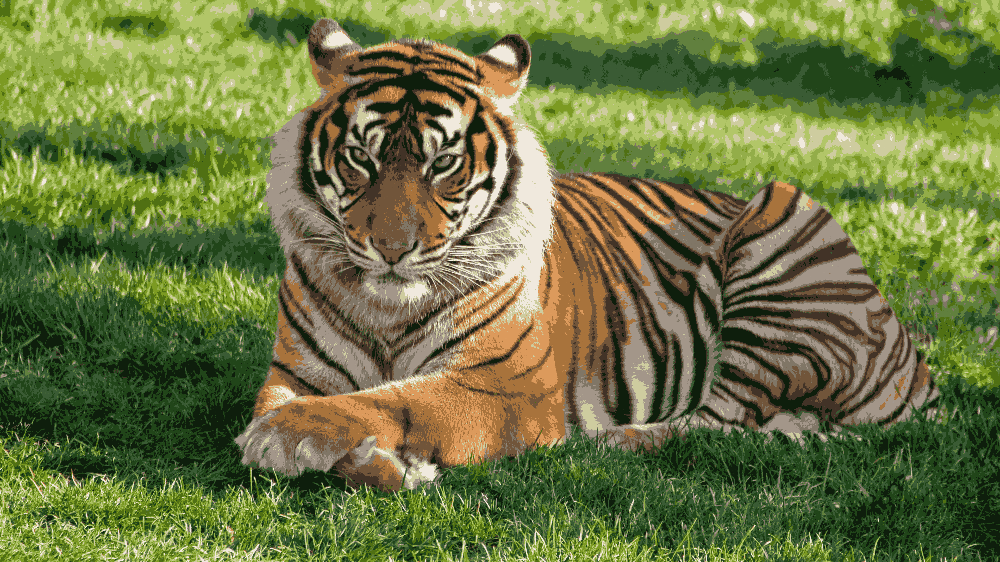

In [22]:
comp_image

In [23]:
comp_image.save('tiger_compressed.png')

In [25]:
img_1 = mpimg.imread('tiger.png')
img_2 = mpimg.imread('tiger_compressed.png')

#### Step10: Original Plotvs Compressed Image

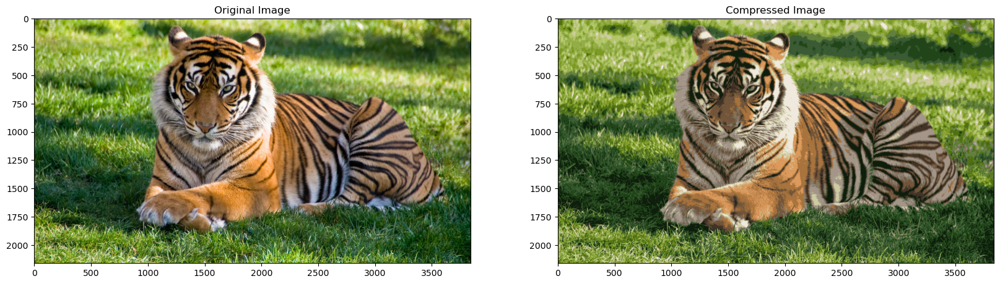

In [26]:
fig, (ax1,ax2) = plt.subplots(1,2, figsize=(20,20))
ax1.imshow(img_1)
ax1.set_title('Original Image')
ax2.imshow(img_2)
ax2.set_title('Compressed Image')
plt.show()

See the differense in the quality of the images. which is reduced by using 16 clusters

END